In [1]:
#Importing the necessary libraries
import torch
import whisper
import pytube
import librosa
import matplotlib.pyplot as plt
import numpy as np
import IPython.display as ipd

## Load Model and data

In [39]:
model_m = whisper.load_model('medium')

100%|█████████████████████████████████████| 1.42G/1.42G [01:45<00:00, 14.4MiB/s]
/opt/anaconda3/lib/python3.12/site-packages/whisper/__init__.py:146: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this e

In [7]:
file_path = 'Data/1.wav'
T = 12*60+37

In [47]:
audio = whisper.load_audio(file_path)

## Trim audio to detect language

In [ ]:
Trim = whisper.pad_or_trim(audio)

In [54]:
n_samples =  Trim.shape[-1]
delta = T/n_samples
sr = 1/delta
#Time of each sample
time = np.linspace(0,(n_samples-1)*delta,n_samples)

In [58]:
mel = whisper.log_mel_spectrogram(Trim).to(model_m.device)


Text(42.597222222222214, 0.5, 'Mel Scale')

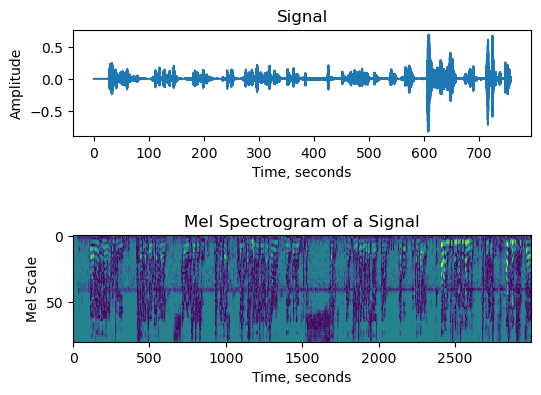

In [59]:
fig, (ax1, ax2) = plt.subplots(2)
fig.tight_layout(pad=5.0)
ax1.plot(time,Trim)
ax1.set_title('Signal')
ax1.set_xlabel('Time, seconds')
ax1.set_ylabel('Amplitude')
ax2.imshow((mel.numpy()*mel.numpy())**(1/2),interpolation='nearest', aspect='auto')
ax2.set_title('Mel Spectrogram of a Signal')
ax2.set_xlabel('Time, seconds')
ax2.set_ylabel('Mel Scale')

In [51]:
ipd.Audio(audio, rate=sr)

In [67]:
probs = model_m.detect_language(mel)
detected_language = max(probs[1], key=probs[1].get)
detected_prob = probs[1][detected_language]
print(f"Detected language: {detected_language} with probability {detected_prob:.2f}")

Detected language: en with probability 1.00


## Create Transcript & generate translation 

In [68]:
transcription = model_m.transcribe(file_path, fp16 = False)['text']

In [69]:
transcription

" Hello everyone and welcome to the second episode of the Hudson Valley Stuttering Association podcast, a place for questions and answers about stuttering and open discussions. I'm TJ Trayvon with us today as Emma Markle. Emma, how are you? Oh, I am just fantastic. How are you? Pretty good. That's great. So, just to build off the intro, Emma and I have been friends for about five or so years now. She is not a person who stutters. I wanted a fluent person on here to see what they think of stuttering and all that stuff. So Emma, this one's a hard ball. When you compare having a friend who stutters to your other friends, other meaning fluent, what's the difference? Well that's a loaded question. I try not to think of my friends who stutter any different from my other friends, but I feel like sometimes I do have to be more patient and more understanding and willing to wait with people who stutter. I think that's the main difference, just being more patient. With my other friends, I can be 

In [71]:
translation = model_m.transcribe(file_path, language = 'zh', fp16 = False)['text']

In [72]:
translation

"大家好,歡迎收看第二集Hudson Valley Stuttering Association的Podcast,是關於stuttering的問題和答案的地方,和開放的討論。我是TJ Trayvon,今天我帶著Emma Markle。Emma,你好嗎?我很好,你呢?很好。很好。就是來想想中感 escaue食與我,我們在這裡了五十年的關係。她是一個沒有人辨識冷知識的人。我想說我是一位有獨多數人發覺她一些故事。所以 Emma。這cier新替我關鍵。你比起有朋友的溫暖和其他朋友的溫暖,你覺得有什麼分別?那是一個重點的問題我試著不想把有朋友的溫暖和其他朋友的溫暖,但我感覺我需要更加耐心,更加懂得,更加願意等待有朋友的溫暖我覺得這是最大的分別,就是要更加耐心我跟其他朋友的溫暖,我可以更加耐心,這是我在說的我一直在想這個問題,我問了很多朋友你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫暖,你覺得有朋友的溫暖和其他朋友的溫�So, another question I ask of my friends too. What was going through your head when we first started talking? Like does this kid need a bandaid or something?I don't think bandaid was my first option. I think it